In [67]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
from pybaseball import batting_stats
from pybaseball import pitching_stats
from pybaseball import lahman
lahman.download_lahman()
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib notebook
import seaborn as sns

In [80]:
# All box score pitching stats with WAR from 2018-2022
pitching_data = pitching_stats(2018,2022)
pitcher_WAR_data = pitching_data[['Season', 'Name', 'Team', 'Age', 'W', 'L', 'WAR', 'ERA', 'G', 'GS', 'CG', 'ShO', 'SV', 'BS', 'IP', 'H', 'R', 'ER', 'HR', 'BB', 'HBP', 'SO']]
pitcher_WAR_data

,Season,Name,Team,Age,W,L,WAR,ERA,G,GS,...,SV,BS,IP,H,R,ER,HR,BB,HBP,SO
1,2018,Jacob deGrom,NYM,30,10,9,9.0,1.70,32,32,...,0,0,217.0,152,48,41,10,46,5,269
23,2019,Gerrit Cole,HOU,28,20,5,7.5,2.50,33,33,...,0,0,212.1,142,66,59,29,48,3,326
25,2018,Max Scherzer,WSN,33,18,7,7.5,2.53,33,33,...,0,0,220.2,150,66,62,23,51,12,300
18,2021,Corbin Burnes,MIL,26,11,5,7.5,2.43,28,28,...,0,0,167.0,123,47,45,7,34,6,234
37,2021,Zack Wheeler,PHI,31,14,10,7.2,2.78,32,32,...,0,0,213.1,169,72,66,16,46,8,247
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
173,2022,Marco Gonzales,SEA,30,10,15,0.1,4.13,32,32,...,0,0,183.0,194,97,84,30,50,7,103
230,2021,Jordan Lyles,TEX,30,10,13,0.1,5.15,32,30,...,0,0,180.0,194,104,103,38,56,7,146
241,2018,Lucas Giolito,CHW,23,10,13,0.1,6.13,32,32,...,0,0,173.1,166,123,118,27,90,15,125
206,2020,Alec Mills,CHC,28,5,5,0.1,4.48,11,11,...,0,0,62.1,53,31,31,13,19,2,46


In [81]:
# Creating separate pitching DataFrames to represent different types of stats
pitcher_wins_saves = pitcher_WAR_data[['WAR', 'W', 'L', 'SV', 'BS']]
pitcher_games_innings = pitcher_WAR_data[['WAR', 'G', 'GS', 'CG', 'ShO', 'IP']]
pitcher_era = pitcher_WAR_data[['WAR', 'H', 'HR', 'R', 'ER', 'ERA']]
pitcher_strikeouts = pitcher_WAR_data[['WAR', 'SO', 'BB', 'HBP']]

<IPython.core.display.Javascript object>


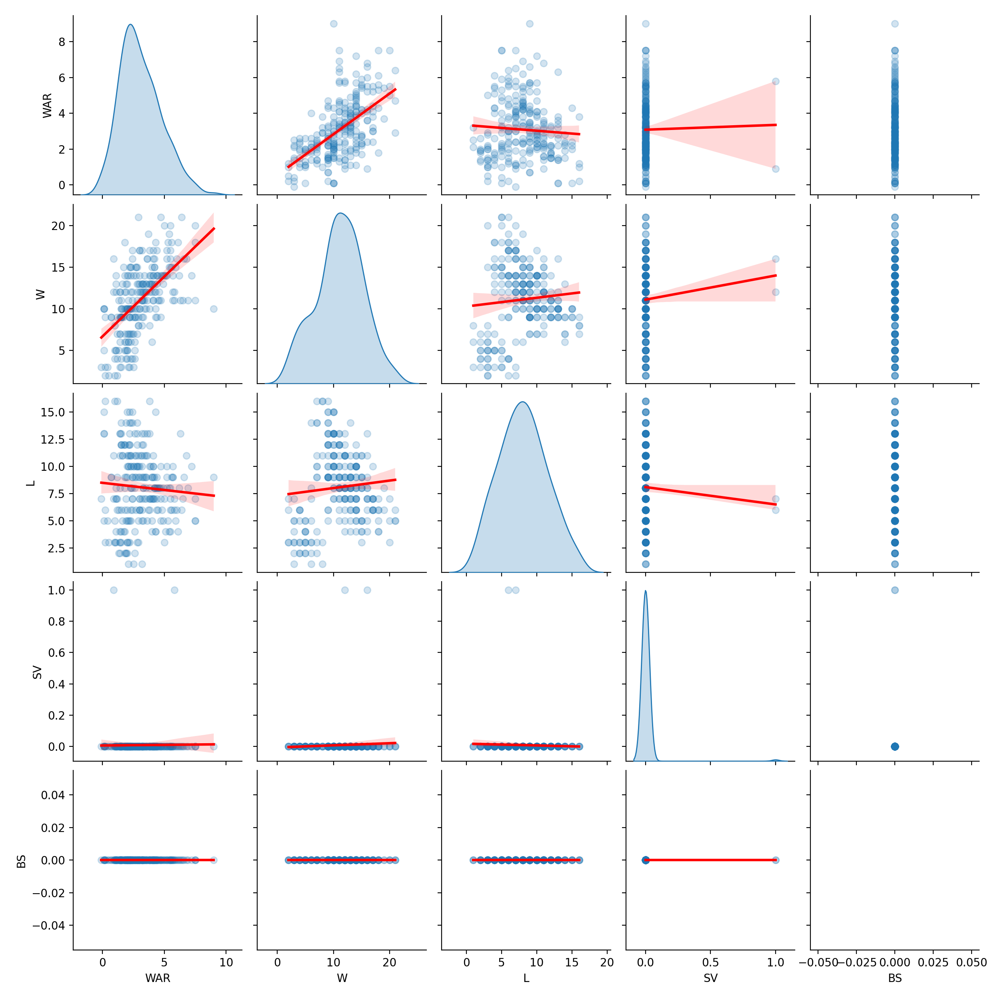

In [82]:
# Pitcher_wins_saves matrix plot
sns.pairplot(pitcher_wins_saves, diag_kind = 'kde', kind='reg', plot_kws={'line_kws':{'color':'red'}, 
                                                                          'scatter_kws':{'alpha':0.2}})
# Wins are most correlated in this group

<IPython.core.display.Javascript object>


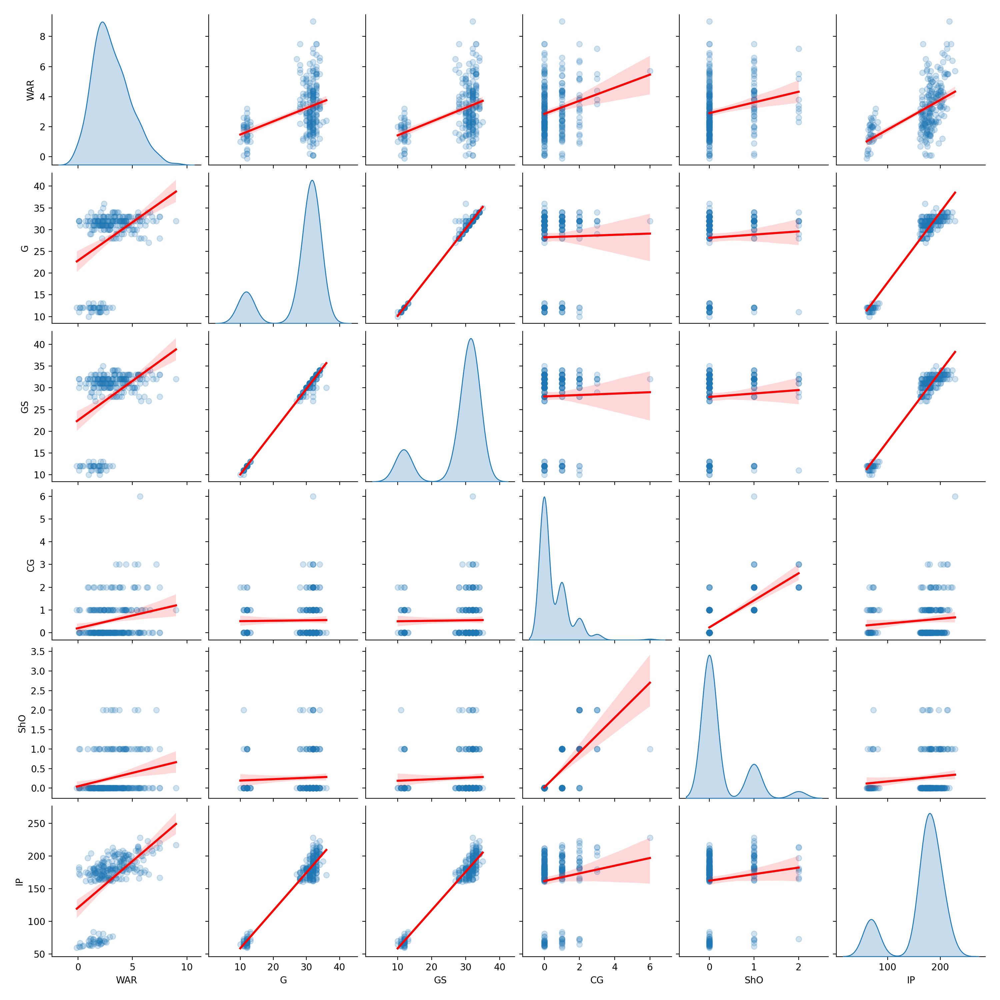

In [83]:
# Pitcher_games_innings matrix plot
sns.pairplot(pitcher_games_innings, diag_kind = 'kde', kind='reg', plot_kws={'line_kws':{'color':'red'}, 
                                                                          'scatter_kws':{'alpha':0.2}})
# Games, Games Started, and Innings Pitched are most correlated in this group

<IPython.core.display.Javascript object>


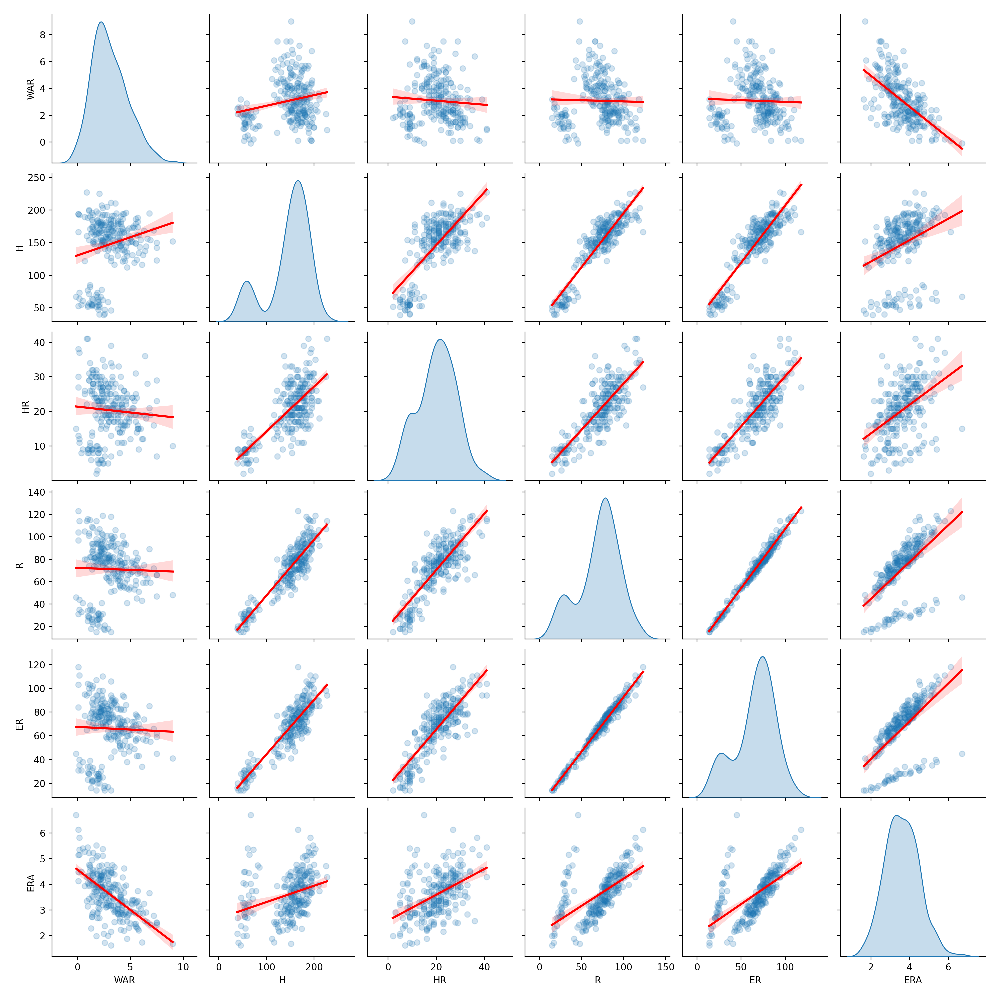

In [84]:
# Pitcher_era matrix plot
sns.pairplot(pitcher_era, diag_kind = 'kde', kind='reg', plot_kws={'line_kws':{'color':'red'}, 
                                                                          'scatter_kws':{'alpha':0.2}})
# Hits are most correlated in this group, but are not a clear positive correlation

<IPython.core.display.Javascript object>


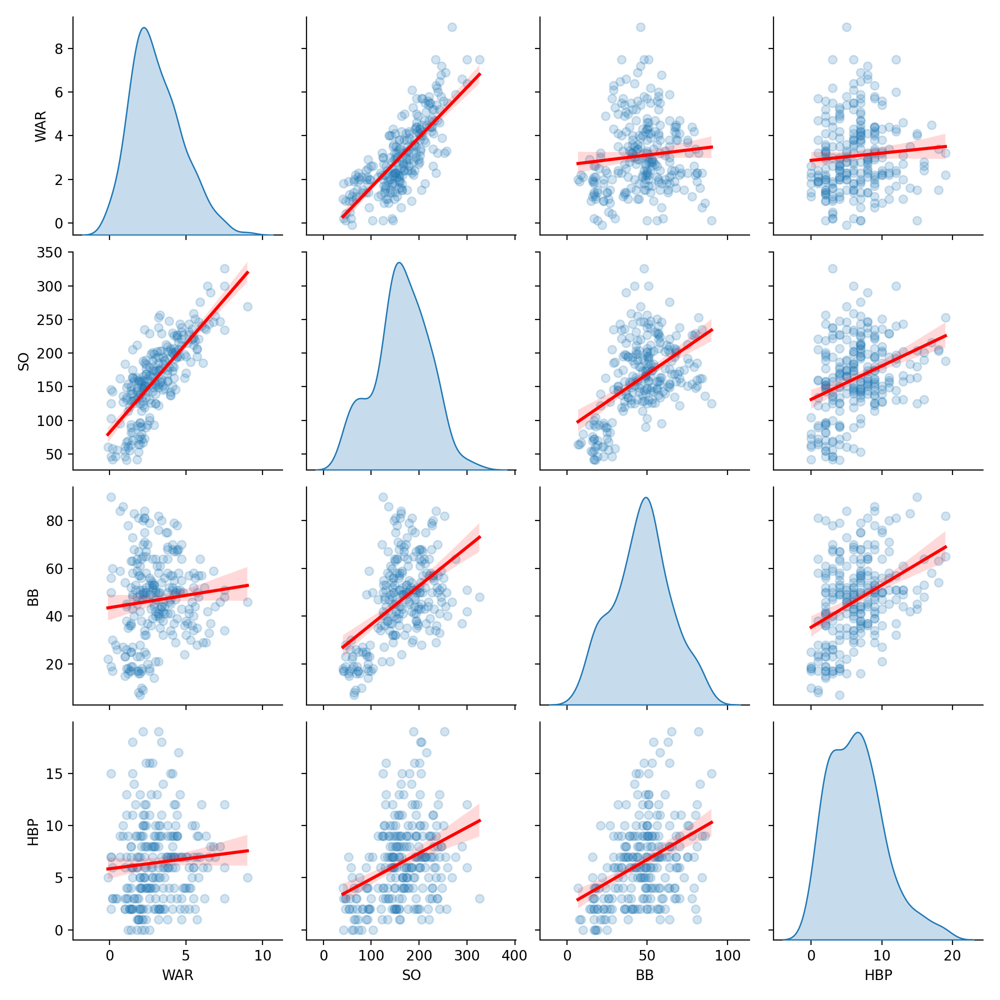

In [85]:
# Pitcher_strikeouts matrix plot
sns.pairplot(pitcher_strikeouts, diag_kind = 'kde', kind='reg', plot_kws={'line_kws':{'color':'red'}, 
                                                                          'scatter_kws':{'alpha':0.2}})
# Strikeouts are most correlated in this group

In [90]:
# New DataFrame with the most correlated stats to pitching WAR
pitcher_WAR_corr = pitcher_WAR_data[['Name', 'WAR', 'W', 'G', 'GS', 'IP', 'SO']]
pitcher_WAR_corr

,Name,WAR,W,G,GS,IP,SO
1,Jacob deGrom,9.0,10,32,32,217.0,269
23,Gerrit Cole,7.5,20,33,33,212.1,326
25,Max Scherzer,7.5,18,33,33,220.2,300
18,Corbin Burnes,7.5,11,28,28,167.0,234
37,Zack Wheeler,7.2,14,32,32,213.1,247
...,...,...,...,...,...,...,...
173,Marco Gonzales,0.1,10,32,32,183.0,103
230,Jordan Lyles,0.1,10,32,30,180.0,146
241,Lucas Giolito,0.1,10,32,32,173.1,125
206,Alec Mills,0.1,5,11,11,62.1,46


<IPython.core.display.Javascript object>


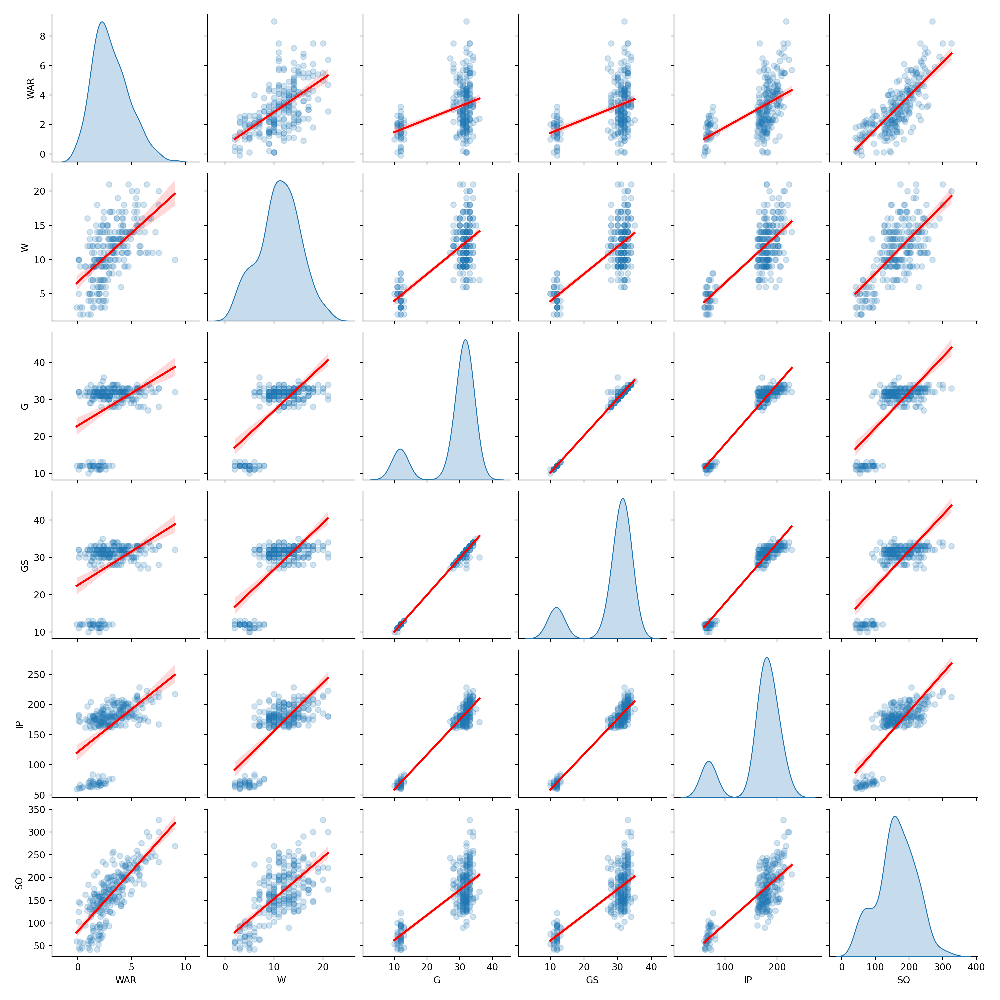

In [91]:
# Matrix plot of most correlated stats to pitching WAR
sns.pairplot(pitcher_WAR_corr, diag_kind = 'kde', kind='reg', plot_kws={'line_kws':{'color':'red'}, 
                                                                          'scatter_kws':{'alpha':0.2}})
# Visually it seems as if Wins and Strikeouts are most positively correlated

In [96]:
# Correlation matrix to determine which stat is most positively correlated
pitcher_WAR_corr.corr()

# Strikeouts is 77.83% correlated to WAR which is the most among box score statistics

,WAR,W,G,GS,IP,SO
WAR,1.000000,0.570973,0.393841,0.408317,0.529834,0.778301
W,0.570973,1.000000,0.698538,0.705301,0.750548,0.677330
G,0.393841,0.698538,1.000000,0.995517,0.966460,0.728666
GS,0.408317,0.705301,0.995517,1.000000,0.970789,0.738871
IP,0.529834,0.750548,0.966460,0.970789,1.000000,0.800208
SO,0.778301,0.677330,0.728666,0.738871,0.800208,1.000000


In [98]:
# All box score batting stats with WAR from 2018-2022
batting_data = batting_stats(2018,2022)
batter_WAR_data = batting_data[['Season', 'Name', 'Team', 'Age', 'WAR', 'G', 'AB', 'PA', 'H', '1B', '2B', '3B', 'HR', 'R', 'RBI', 'BB', 'SO', 'HBP', 'SB', 'AVG', 'OBP', 'SLG', 'OPS']]
batter_WAR_data

,Season,Name,Team,Age,WAR,G,AB,PA,H,1B,...,R,RBI,BB,SO,HBP,SB,AVG,OBP,SLG,OPS
1,2022,Aaron Judge,NYY,30,11.4,157,570,696,177,87,...,133,131,111,175,6,16,0.311,0.425,0.686,1.111
3,2018,Mookie Betts,BOS,25,10.5,136,520,614,180,96,...,129,80,81,91,8,30,0.346,0.438,0.640,1.078
4,2018,Mike Trout,LAA,26,9.5,140,471,608,147,80,...,101,79,122,124,10,24,0.312,0.460,0.628,1.088
7,2019,Mike Trout,LAA,27,8.4,134,470,600,137,63,...,110,104,110,120,16,11,0.291,0.438,0.645,1.083
16,2019,Alex Bregman,HOU,25,8.1,156,554,690,164,84,...,122,112,119,83,9,5,0.296,0.423,0.592,1.015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
627,2021,Hunter Dozier,KCR,29,-1.0,144,487,543,105,56,...,55,54,43,154,7,5,0.216,0.285,0.394,0.680
634,2020,J.D. Martinez,BOS,32,-1.0,54,211,237,45,22,...,22,27,22,59,2,1,0.213,0.291,0.389,0.680
668,2020,Jonathan Villar,- - -,29,-1.1,52,185,207,43,36,...,13,15,19,54,0,16,0.232,0.301,0.292,0.593
650,2018,Victor Martinez,DET,39,-1.7,133,467,508,117,87,...,32,54,32,49,2,0,0.251,0.297,0.353,0.651


In [99]:
# Creating separate batting DataFrames to represent different types of stats
batter_bip = batter_WAR_data[['WAR', 'H', '1B', '2B', '3B', 'HR']]
batter_games = batter_WAR_data[['WAR', 'G', 'AB', 'PA', 'R', 'RBI']]
batter_averages = batter_WAR_data[['WAR', 'AVG', 'OBP', 'SLG', 'OPS']]
batter_non_bip = batter_WAR_data[['WAR', 'SO', 'BB', 'HBP', 'SB']]

<IPython.core.display.Javascript object>


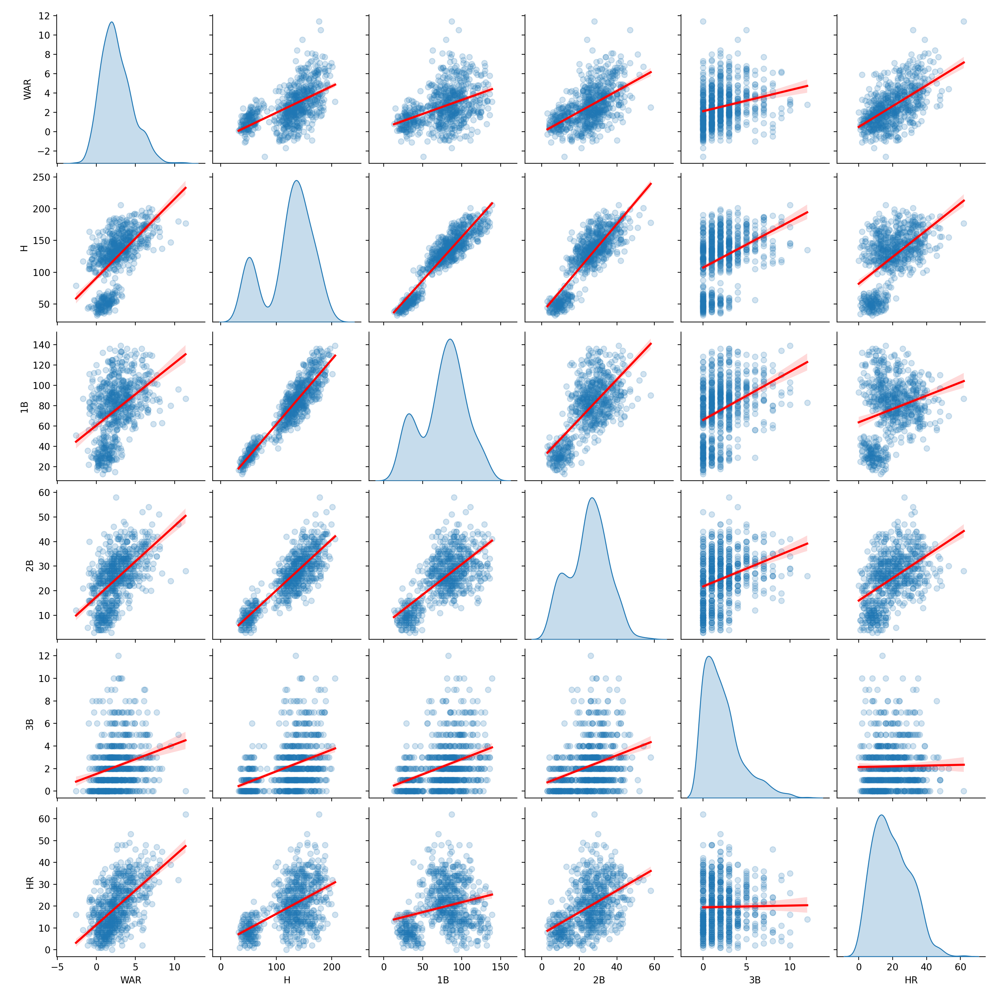

In [100]:
# Batter_bip matrix plot
sns.pairplot(batter_bip, diag_kind = 'kde', kind='reg', plot_kws={'line_kws':{'color':'red'}, 
                                                                          'scatter_kws':{'alpha':0.2}})
# Hits and Homeruns are most correlated in this group

<IPython.core.display.Javascript object>


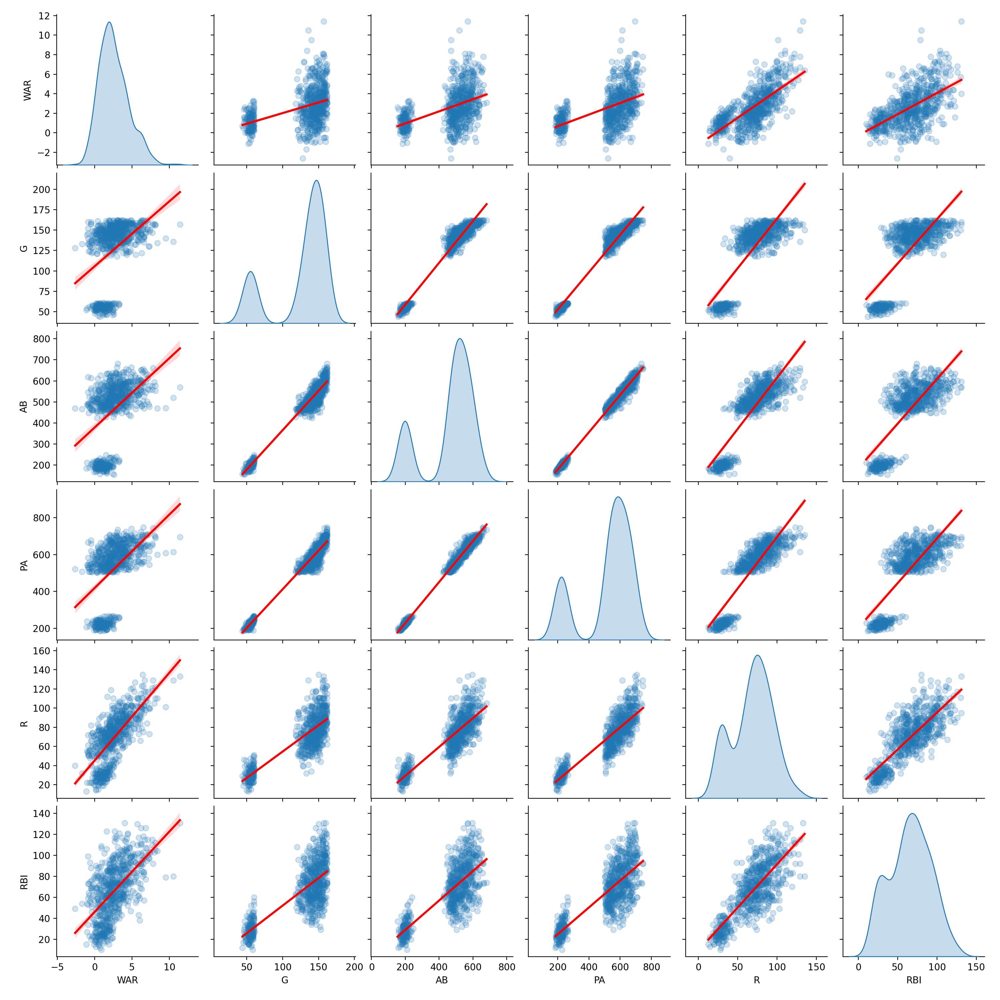

In [101]:
# Batter_games matrix plot
sns.pairplot(batter_games, diag_kind = 'kde', kind='reg', plot_kws={'line_kws':{'color':'red'}, 
                                                                          'scatter_kws':{'alpha':0.2}})
# Most of these stats are strongly correlated to WAR, but it seems like Runs and RBIs are slightly more correlated to WAR

<IPython.core.display.Javascript object>


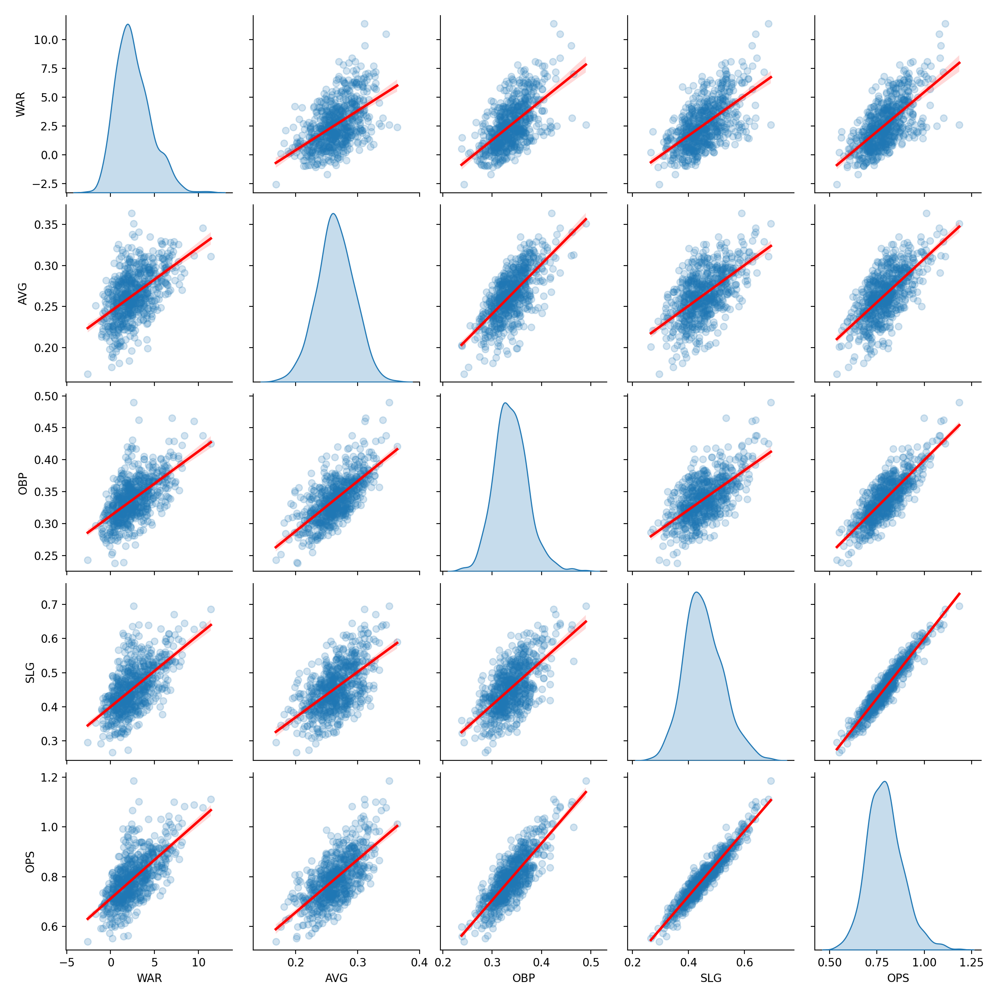

In [102]:
# Batter_averages matrix plot
sns.pairplot(batter_averages, diag_kind = 'kde', kind='reg', plot_kws={'line_kws':{'color':'red'}, 
                                                                          'scatter_kws':{'alpha':0.2}})
# OBP and OPS are most correlated in this group

<IPython.core.display.Javascript object>


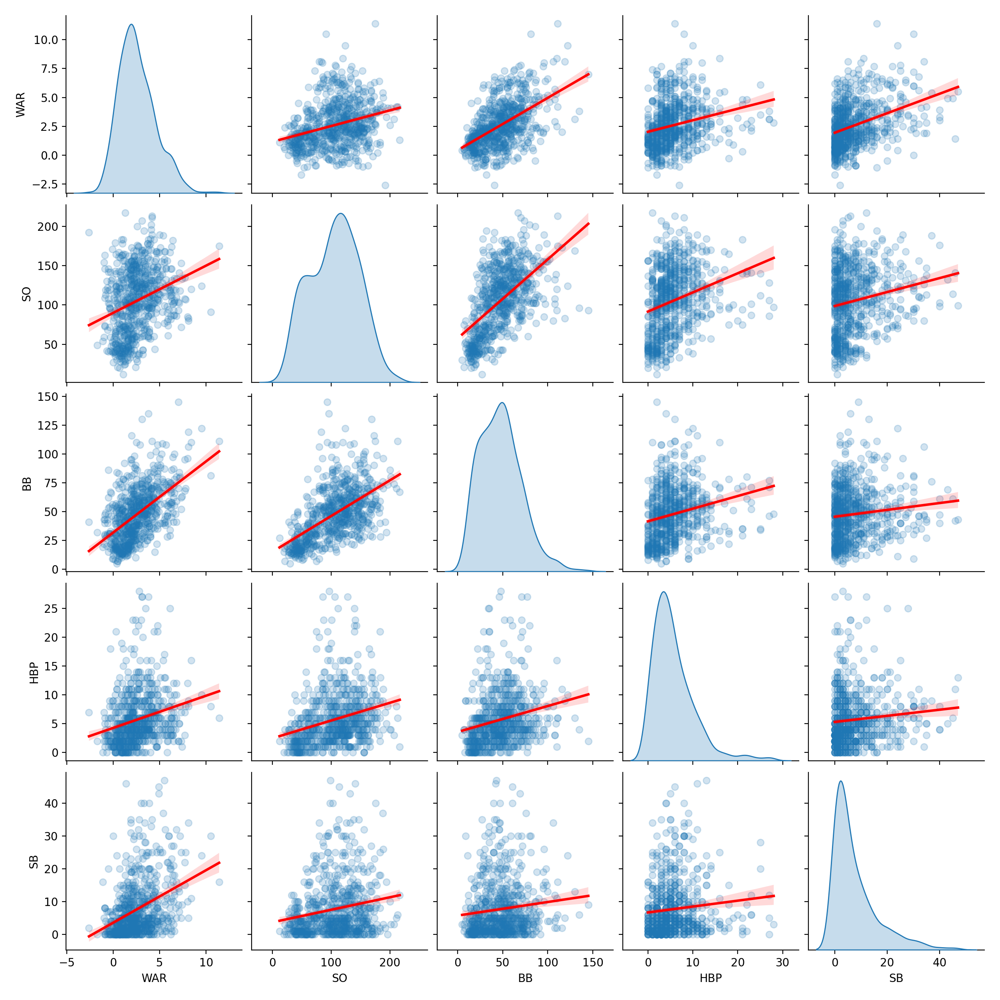

In [103]:
# Batter_non_bip matrix plot
sns.pairplot(batter_non_bip, diag_kind = 'kde', kind='reg', plot_kws={'line_kws':{'color':'red'}, 
                                                                          'scatter_kws':{'alpha':0.2}})
# Walks are most correlated in this group

In [104]:
# New DataFrame with the most correlated stats to batting WAR
batter_WAR_corr = batter_WAR_data[['Name', 'WAR', 'H', 'HR', 'R', 'RBI', 'BB', 'OBP', 'OPS']]
batter_WAR_corr

,Name,WAR,H,HR,R,RBI,BB,OBP,OPS
1,Aaron Judge,11.4,177,62,133,131,111,0.425,1.111
3,Mookie Betts,10.5,180,32,129,80,81,0.438,1.078
4,Mike Trout,9.5,147,39,101,79,122,0.460,1.088
7,Mike Trout,8.4,137,45,110,104,110,0.438,1.083
16,Alex Bregman,8.1,164,41,122,112,119,0.423,1.015
...,...,...,...,...,...,...,...,...,...
627,Hunter Dozier,-1.0,105,16,55,54,43,0.285,0.680
634,J.D. Martinez,-1.0,45,7,22,27,22,0.291,0.680
668,Jonathan Villar,-1.1,43,2,13,15,19,0.301,0.593
650,Victor Martinez,-1.7,117,9,32,54,32,0.297,0.651


<IPython.core.display.Javascript object>


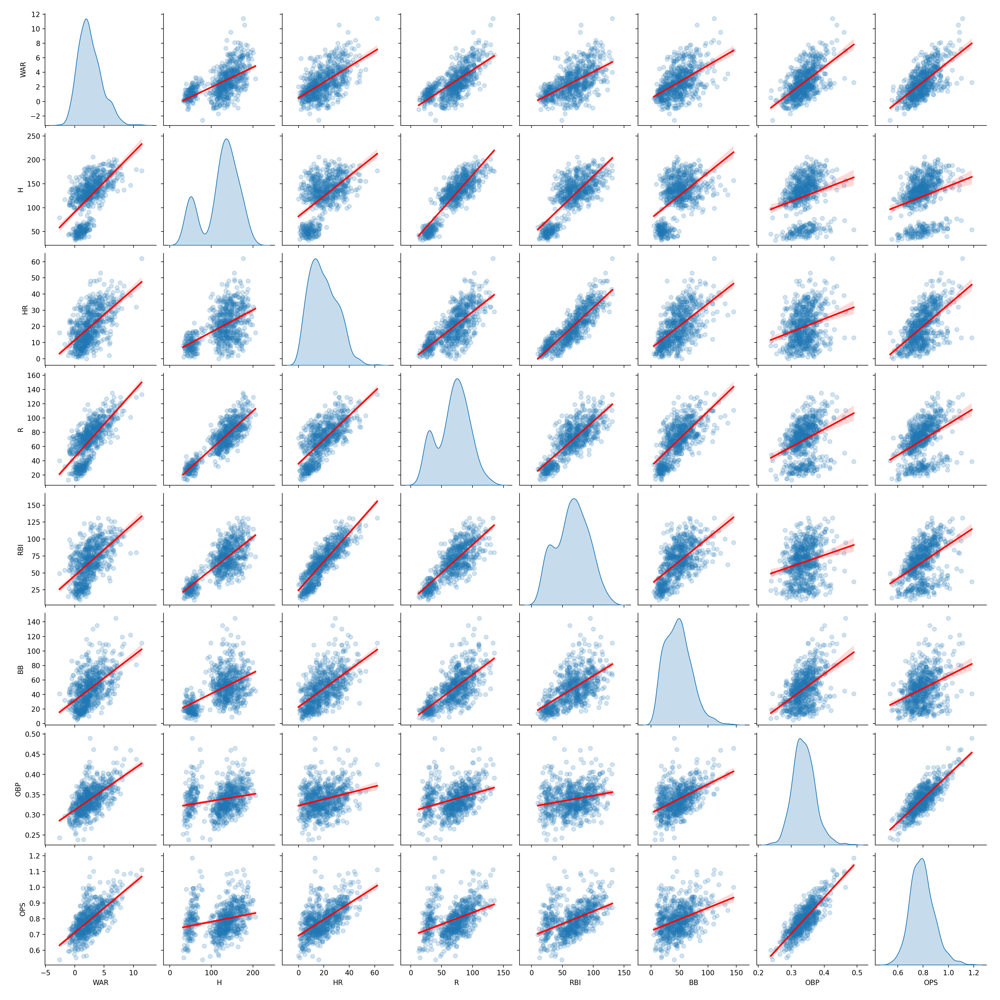

In [108]:
# Matrix plot of most correlated stats to batting WAR
sns.pairplot(batter_WAR_corr, diag_kind = 'kde', kind='reg', plot_kws={'line_kws':{'color':'red'}, 
                                                                          'scatter_kws':{'alpha':0.2}})
# Visually it seems as if Runs and OPS are most positively correlated

In [107]:
# Correlation matrix to determine which stat is most positively correlated
batter_WAR_corr.corr()

# Runs is 71.44% correlated to WAR which is the most among box score statistics

,WAR,H,HR,R,RBI,BB,OBP,OPS
WAR,1.000000,0.583690,0.583353,0.714397,0.577583,0.529210,0.590827,0.654426
H,0.583690,1.000000,0.537161,0.879306,0.771576,0.521174,0.211779,0.233489
HR,0.583353,0.537161,1.000000,0.713834,0.863469,0.592449,0.252416,0.585151
R,0.714397,0.879306,0.713834,1.000000,0.798322,0.697615,0.330426,0.401709
RBI,0.577583,0.771576,0.863469,0.798322,1.000000,0.596534,0.214559,0.443957
BB,0.529210,0.521174,0.592449,0.697615,0.596534,1.000000,0.487114,0.355991
OBP,0.590827,0.211779,0.252416,0.330426,0.214559,0.487114,1.000000,0.821281
OPS,0.654426,0.233489,0.585151,0.401709,0.443957,0.355991,0.821281,1.000000


In [128]:
# Pitching data from 1871-2000
all_pitching_data = pitching_stats(1871, 2000)
all_pitcher_WAR_data = all_pitching_data[['Name', 'WAR', 'W', 'L', 'ERA', 'G', 'GS', 'CG', 'ShO', 'SV', 'BS', 'IP', 'H', 'R', 'ER', 'HR', 'BB', 'HBP', 'SO']]
all_pitcher_WAR_data

,Name,WAR,W,L,ERA,G,GS,CG,ShO,SV,BS,IP,H,R,ER,HR,BB,HBP,SO
343,Pedro Martinez,11.6,23,4,2.07,31,29,5,1,0,NaN,213.1,160,56,49,9.0,37,9.0,313
79,Silver King,11.1,45,21,1.64,66,65,64,6,0,NaN,585.2,437,205,107,6.0,76,0.0,258
261,Steve Carlton,11.1,27,10,1.97,41,41,30,8,0,NaN,346.1,257,84,76,17.0,87,1.0,310
1626,John Clarkson,10.9,49,19,2.73,73,72,68,8,1,NaN,620.0,589,280,188,16.0,203,17.0,284
918,Toad Ramsey,10.9,38,27,2.45,67,67,66,3,0,NaN,588.2,447,297,160,3.0,207,12.0,499
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8515,Phil Ortega,-1.9,12,15,5.11,35,29,4,2,0,NaN,179.2,176,107,102,33.0,97,5.0,88
8957,George Mitchell,-1.9,4,6,6.35,17,13,7,1,0,NaN,90.2,107,91,64,NaN,55,2.0,36
8944,Hulon Stamps,-1.9,0,13,6.24,20,10,4,0,0,NaN,115.1,134,98,80,NaN,36,2.0,37
9016,Charlie Beverly,-2.0,5,12,7.88,29,16,6,0,0,NaN,128.0,175,120,112,NaN,49,3.0,44


In [129]:
# Correlation matrix for pitching WAR
all_pitcher_WAR_data.corr()

# Strikeouts  is still most correlated at 69.71% with Wins close behind at 68.09%

,WAR,W,L,ERA,G,GS,CG,ShO,SV,BS,IP,H,R,ER,HR,BB,HBP,SO
WAR,1.000000,0.680884,0.188978,-0.489145,0.454505,0.592117,0.458850,0.511301,0.048175,NaN,0.635193,0.471853,0.233107,0.221718,0.009902,0.171095,0.062444,0.697081
W,0.680884,1.000000,0.214302,-0.472914,0.643256,0.751826,0.682246,0.558713,0.067155,NaN,0.835361,0.678405,0.453184,0.403014,0.054353,0.378147,0.197747,0.557432
L,0.188978,0.214302,1.000000,0.054477,0.575017,0.619989,0.528053,0.109820,-0.014359,NaN,0.642440,0.719605,0.731163,0.693442,0.060153,0.450979,0.235149,0.253705
ERA,-0.489145,-0.472914,0.054477,1.000000,-0.217759,-0.231499,-0.363430,-0.531039,-0.117049,NaN,-0.370945,-0.090789,0.172277,0.371505,0.325090,0.025825,-0.109328,-0.325193
G,0.454505,0.643256,0.575017,-0.217759,1.000000,0.721791,0.479947,0.345463,0.358795,NaN,0.794706,0.739004,0.575269,0.613990,0.170259,0.515924,0.201783,0.477796
GS,0.592117,0.751826,0.619989,-0.231499,0.721791,1.000000,0.575404,0.418335,-0.138486,NaN,0.901411,0.825226,0.662531,0.699739,0.323820,0.537343,0.246861,0.647579
CG,0.458850,0.682246,0.528053,-0.363430,0.479947,0.575404,1.000000,0.434180,0.030041,NaN,0.817015,0.769534,0.694974,0.458658,-0.314691,0.338355,0.264179,0.261231
ShO,0.511301,0.558713,0.109820,-0.531039,0.345463,0.418335,0.434180,1.000000,0.052818,NaN,0.485313,0.273560,0.044042,-0.002449,-0.089205,0.148490,0.105725,0.411012
SV,0.048175,0.067155,-0.014359,-0.117049,0.358795,-0.138486,0.030041,0.052818,1.000000,NaN,0.033504,0.010808,-0.057611,-0.054429,-0.129854,0.017209,-0.026495,-0.045234
BS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [124]:
# Batting data from 1871-2000
all_batting_data = batting_stats(1871, 2000)
all_batter_WAR_data = all_batting_data[['Name', 'WAR', 'G', 'AB', 'PA', 'H', '1B', '2B', '3B', 'HR', 'R', 'RBI', 'BB', 'SO', 'HBP', 'SB', 'AVG', 'OBP', 'SLG', 'OPS']]
all_batter_WAR_data

,Name,WAR,G,AB,PA,H,1B,2B,3B,HR,R,RBI,BB,SO,HBP,SB,AVG,OBP,SLG,OPS
4,Babe Ruth,14.7,152,522,699,205,106,45,13,41,151,131.0,170,93.0,4.0,17.0,0.393,0.545,0.764,1.309
3,Babe Ruth,13.8,152,540,693,204,85,44,16,59,177,171.0,145,81.0,4.0,17.0,0.378,0.512,0.846,1.359
1,Babe Ruth,13.2,142,457,615,172,73,36,9,54,158,137.0,150,80.0,3.0,14.0,0.376,0.533,0.849,1.382
13,Babe Ruth,13.0,151,540,691,192,95,29,8,60,158,164.0,137,89.0,0.0,7.0,0.356,0.486,0.772,1.258
15,Lou Gehrig,12.4,155,584,717,218,101,52,18,47,149,175.0,109,84.0,3.0,10.0,0.373,0.474,0.765,1.240
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10102,Jose Guillen,-3.1,143,498,526,133,94,20,5,14,58,70.0,17,88.0,8.0,1.0,0.267,0.300,0.412,0.712
12611,Jim Levey,-3.2,139,498,540,104,78,19,2,5,53,38.0,35,83.0,2.0,13.0,0.209,0.264,0.285,0.549
12987,Jim Lillie,-3.2,114,416,427,73,64,9,0,0,37,22.0,11,80.0,NaN,13.0,0.175,0.197,0.197,0.394
11141,Tommy Thevenow,-3.5,156,573,624,164,142,21,1,0,57,78.0,23,26.0,2.0,1.0,0.286,0.316,0.326,0.642


In [126]:
# Correlation matrix for batting WAR
all_batter_WAR_data.corr()

# Runs is less correlated than OBP, SLG, and OPS which is 73.16% correlated to WAR

,WAR,G,AB,PA,H,1B,2B,3B,HR,R,RBI,BB,SO,HBP,SB,AVG,OBP,SLG,OPS
WAR,1.000000,0.328752,0.340913,0.410001,0.568785,0.363361,0.504153,0.288557,0.480472,0.642181,0.563383,0.533558,0.143932,0.152366,0.175348,0.585404,0.688472,0.677858,0.731626
G,0.328752,1.000000,0.943937,0.958368,0.789931,0.696301,0.577399,0.146838,0.382357,0.515991,0.509385,0.539334,0.463089,0.086276,0.094239,0.001054,0.162660,0.173969,0.182505
AB,0.340913,0.943937,1.000000,0.981605,0.886902,0.812467,0.627708,0.248027,0.333753,0.629421,0.522622,0.434979,0.345067,0.081291,0.177070,0.100973,0.146715,0.190498,0.187950
PA,0.410001,0.958368,0.981605,1.000000,0.876536,0.784715,0.630875,0.229792,0.374241,0.671557,0.545163,0.588830,0.378329,0.125395,0.181415,0.112539,0.261281,0.230156,0.258880
H,0.568785,0.789931,0.886902,0.876536,1.000000,0.898493,0.740830,0.366035,0.357203,0.762388,0.640078,0.423448,0.143669,0.090433,0.193798,0.527062,0.469437,0.475301,0.508004
1B,0.363361,0.696301,0.812467,0.784715,0.898493,1.000000,0.473127,0.339363,-0.013046,0.606432,0.338032,0.266258,-0.109893,0.071899,0.301512,0.445713,0.332259,0.130040,0.216172
2B,0.504153,0.577399,0.627708,0.630875,0.740830,0.473127,1.000000,0.183399,0.399804,0.581643,0.616735,0.369833,0.193815,0.049858,-0.010550,0.439485,0.420234,0.561413,0.549206
3B,0.288557,0.146838,0.248027,0.229792,0.366035,0.339363,0.183399,1.000000,-0.173315,0.390303,0.175712,0.023702,-0.225460,0.080641,0.342323,0.322383,0.218664,0.196330,0.219214
HR,0.480472,0.382357,0.333753,0.374241,0.357203,-0.013046,0.399804,-0.173315,1.000000,0.415959,0.733807,0.451962,0.615762,0.033879,-0.242162,0.164018,0.316744,0.746456,0.638574
R,0.642181,0.515991,0.629421,0.671557,0.762388,0.606432,0.581643,0.390303,0.415959,1.000000,0.587023,0.574103,0.162668,0.208391,0.376052,0.485132,0.589065,0.540849,0.598790
